In [10]:
# This script sets up the environment for a project that involves audio and video processing.
import pandas as pd
import numpy as np
import cv2
import matplotlib.pyplot as plt

from glob import glob

import IPython.display as ipd
from tqdm import tqdm

import subprocess

plt.style.use('ggplot')

In [11]:
# use the kagglehub package to download a dataset from Kaggle.
'''
import kagglehub

# Download latest version
path = kagglehub.dataset_download("robikscube/driving-video-with-object-tracking")

print("Path to dataset files:", path)
'''

'\nimport kagglehub\n\n# Download latest version\npath = kagglehub.dataset_download("robikscube/driving-video-with-object-tracking")\n\nprint("Path to dataset files:", path)\n'

Step 1: Convert .mov Video to .mp4 Using OpenCV

In [12]:
import cv2
import os

# Path to input .mov file
input_path = r'D:\Video-Data-Processing-with-Python-and-OpenCV\kagglehub\datasets\robikscube\driving-video-with-object-tracking\versions\1\bdd100k_videos_train_00\bdd100k\videos\train\026c7465-309f6d33.mov'

# Path to output .mp4 file
output_path = r'D:\Video-Data-Processing-with-Python-and-OpenCV\converted_output\converted_026c7465-309f6d33.mp4'

# Open the input video
cap = cv2.VideoCapture(input_path)

if not cap.isOpened():
    print("Could not open input video.")
    exit()

# Get original video properties
fps = cap.get(cv2.CAP_PROP_FPS)
width  = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))

# Define codec and create VideoWriter object
fourcc = cv2.VideoWriter_fourcc(*'mp4v')  # Codec for mp4
out = cv2.VideoWriter(output_path, fourcc, fps, (width, height))

# Read frames from input and write to output
while True:
    ret, frame = cap.read()
    if not ret:
        break
    out.write(frame)

# Release both reader and writer
cap.release()
out.release()

print("Video converted and saved successfully.")


Video converted and saved successfully.


Step 2: Load Video Frames into Memory for Visualization

In [13]:
import cv2
import matplotlib.pyplot as plt

# Path to the converted .mp4 file
video_path = r'D:\Video-Data-Processing-with-Python-and-OpenCV\converted_output\converted_026c7465-309f6d33.mp4'

# Open the video file
cap = cv2.VideoCapture(video_path)

# Initialize an empty list to store frames
frames = []

# Limit number of frames to avoid memory issues
max_frames = 300

# Read frames one by one
while len(frames) < max_frames:
    ret, frame = cap.read()
    if not ret:
        break
    # Convert from BGR (OpenCV) to RGB (matplotlib expects RGB)
    # Rotate 90 degrees clockwise
    frame = cv2.rotate(frame, cv2.ROTATE_90_CLOCKWISE)

    # Flip vertically to fix upside-down orientation
    frame = cv2.flip(frame, 0)  # 0 = vertical flip

    # Convert to RGB
    frame_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
    frames.append(frame_rgb)


# Release the video file
cap.release()

print(f"Total frames loaded: {len(frames)}")


Total frames loaded: 300


Step 3: Display Loaded Frames as an Animation in Notebook

In [14]:
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

# Create a matplotlib figure
fig, ax = plt.subplots(figsize=(10, 6))

# Display the first frame initially
im = ax.imshow(frames[0])

# Hide axis ticks and labels
ax.axis('off')

# Update function for animation
def update(frame_idx):
    im.set_array(frames[frame_idx])
    return [im]

# Create animation object using FuncAnimation
anim = FuncAnimation(fig, update, frames=len(frames), interval=50)

# Prevent double output in Jupyter
plt.close()

# Display animation inside Jupyter Notebook
HTML(anim.to_jshtml())


Animation size has reached 21330234 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


Step 4: Save Animation as .mp4 or .gif

In [15]:
# save as GIF (requires pillow or ImageMagick)
anim.save("video_animation.gif", writer='pillow', fps=20)


In [16]:
!ls -GFlash --color

total 169M
4.0K drwxr-xr-x 1 DELL    0 Jun 17 20:34 ./
4.0K drwxr-xr-x 1 DELL    0 Jun 17 08:27 ../
4.0K drwxr-xr-x 1 DELL    0 Jun 17 14:19 .git/
8.0K -rw-r--r-- 1 DELL 4.6K Jun 17 14:17 .gitignore
 24M -rw-r--r-- 1 DELL  24M Jun 17 20:39 1_data_preparation_and_colormap.ipynb
 11M -rw-r--r-- 1 DELL  11M Jun 17 20:04 2_single_frame_visualization.ipynb
 24M -rw-r--r-- 1 DELL  24M Jun 17 20:04 3_full_video_annotation_export.ipynb
4.0K -rw-r--r-- 1 DELL 2.9K Jun 17 19:05 README.md
   0 drwxr-xr-x 1 DELL    0 Jun 17 20:37 converted_output/
   0 drwxr-xr-x 1 DELL    0 Jun 17 14:16 kagglehub/
1.0K -rw-r--r-- 1 DELL   77 Jun 17 20:25 requirements.txt
   0 drwxr-xr-x 1 DELL    0 Jun 17 20:27 venv/
 53M -rw-r--r-- 1 DELL  53M Jun 17 20:42 video_animation.gif
 59M -rw-r--r-- 1 DELL  59M Jun 17 18:38 video_data_processing.ipynb


Open Video & Read Metadata

In [17]:
import cv2

# Path to your converted video
video_path = r'D:\Video-Data-Processing-with-Python-and-OpenCV\converted_output\converted_026c7465-309f6d33.mp4'

# Load the video
cap = cv2.VideoCapture(video_path)

# Check if the video opened successfully
if not cap.isOpened():
    print("❌ Could not open the video file.")
else:
    # Get video metadata
    total_frames = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))
    fps = cap.get(cv2.CAP_PROP_FPS)
    width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
    height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
    duration = total_frames / fps if fps > 0 else 0

    # Print metadata
    print("📄 Video Metadata:")
    print(f"   ▶ Total Frames : {total_frames}")
    print(f"   ▶ FPS          : {fps}")
    print(f"   ▶ Width        : {width}")
    print(f"   ▶ Height       : {height}")
    print(f"   ▶ Resolution   : {width} x {height}")
    print(f"   ▶ Duration     : {duration:.2f} seconds")

# Release the capture
cap.release()


📄 Video Metadata:
   ▶ Total Frames : 1204
   ▶ FPS          : 30.09
   ▶ Width        : 720
   ▶ Height       : 1280
   ▶ Resolution   : 720 x 1280
   ▶ Duration     : 40.01 seconds


Step: Pulling Frames (Images) from Video and Displaying

✅ Frame captured — shape: (1280, 720, 3)


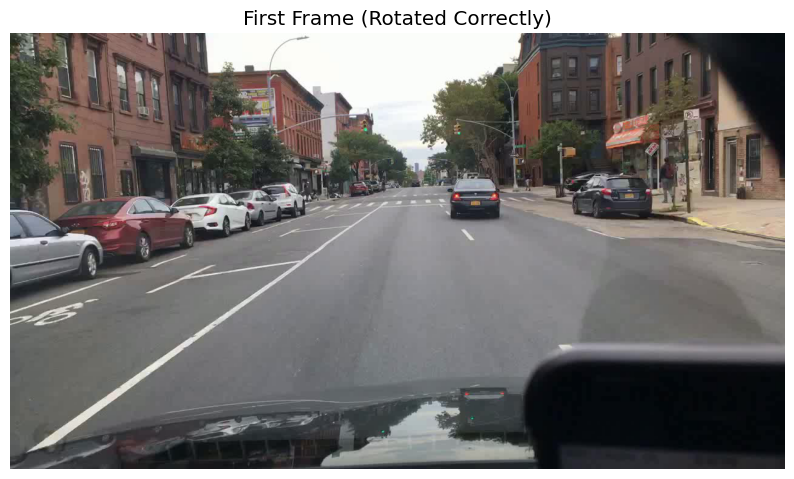

In [18]:
import cv2
import matplotlib.pyplot as plt

# Load the video
video_path = r'D:\Video-Data-Processing-with-Python-and-OpenCV\converted_output\converted_026c7465-309f6d33.mp4'
cap = cv2.VideoCapture(video_path)

# Read the first frame
ret, img = cap.read()

# Confirm image capture
if not ret:
    print("❌ Could not read a frame from the video.")
else:
    print(f"✅ Frame captured — shape: {img.shape}")

    # Rotate the image if needed (adjust based on your issue)
  
    # 180-degree rotation (upside-down)
    #img = cv2.rotate(img, cv2.ROTATE_180)
    
    # For sideways videos:
    #img = cv2.rotate(img, cv2.ROTATE_90_CLOCKWISE)  
    img = cv2.rotate(img, cv2.ROTATE_90_COUNTERCLOCKWISE) 

    # Convert BGR to RGB for display
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    # Display the frame
    plt.figure(figsize=(10, 6))
    plt.imshow(img_rgb)
    plt.axis("off")
    plt.title("First Frame (Rotated Correctly)")
    plt.show()

cap.release()
